# Homework 3: Twitter Analysis
## Joseph Nave and Sam Bacon
### April 5, 2021

Progress Report #1:

I have successfully converted the data from R and loaded it into a Python dataframe called 'officeData.' I also have begun the process of tokenizing all of the lines and sorting them by speaker. My next step is to finish tokenizing and to create the majority of my visualizations. One slight difficulty that I am having is figuring out how to combine all of the tokenized words into a single list that I can use to create the visualizations. However, I am confident that I will be able to resolve this quickly.

In [ ]:
# import libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import datetime as dt
import calendar as cal
import networkx as nx
from operator import itemgetter

In [ ]:
# read in data
twitter_csv = 'https://drive.google.com/uc?export=download&id=1ReTRAhHv_IsWv_gE1sm99lfhu-VkEaYU'
twitter = pd.read_csv(twitter_csv)
twitter.head(10)

,Date,Screen Name,Full Name,Tweet Text,Tweet ID,App,Followers,Follows,Retweets,Favorites,Verfied,User Since,Location,Bio,Profile Image
0,3/15/16,@_Lightscap3s_,Otis,"RT @NatureBridge: ""NatureBridge is Highlight o...",710000000000000000.00,RoundTeam,2644,590.00,1,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
1,3/21/16,@_Lightscap3s_,Otis,RT @NatureBridge: By 2050 we want more fish th...,712000000000000000.00,RoundTeam,2641,587.00,2,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
2,4/6/16,@_Lindsay_Conway,Lindsay,RT @savageducates: Greenest School on #Earth s...,718000000000000000.00,Twitter for iPhone,164,318.00,2,0,No,6/7/14,"Bratislava, Slovakia",International education. SEN interests. Adopti...,View
3,3/23/16,@_mcisneros19,Mirella Cisneros,A1: For math children could measure trunks to ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
4,3/23/16,@_mcisneros19,Mirella Cisneros,A2: Going outside & letting children find the ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
5,3/23/16,@_mcisneros19,Mirella Cisneros,A4: It is important to make Ss aware about the...,713000000000000000.00,TweetDeck,8,44.00,0,1,No,2/4/16,NaN,NaN,View
6,3/23/16,@_mcisneros19,Mirella Cisneros,A4: Learning how we may contribute to the cont...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
7,3/28/16,@_mcisneros19,Mirella Cisneros,Has technology imprisoned children? Do they kn...,715000000000000000.00,Twitter Web Client,10,44.00,0,0,No,2/4/16,NaN,NaN,View
8,3/31/16,@_mcisneros19,Mirella Cisneros,Some helpful tips and activities for teaching ...,716000000000000000.00,Twitter Web Client,11,44.00,0,0,No,2/4/16,NaN,NaN,View
9,4/7/16,@_mcisneros19,Mirella Cisneros,"""...school isn't supposed to be a polite form ...",718000000000000000.00,Twitter Web Client,9,44.00,0,0,No,2/4/16,NaN,NaN,View


2a) App usage

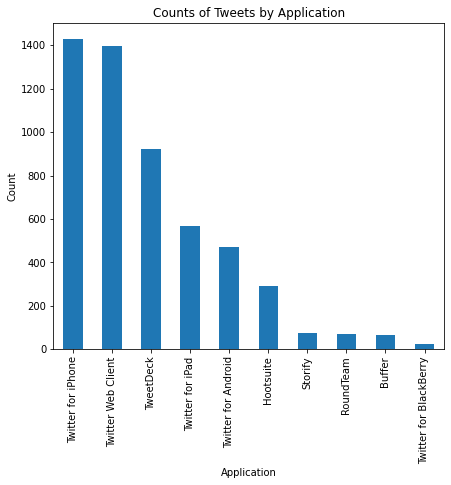

In [ ]:
# Top 10 apps
twitter['App'].value_counts().nlargest(10).plot(kind='bar', figsize=(7, 6))
plt.xlabel('Application')
plt.ylabel('Count')
plt.title('Counts of Tweets by Application')
plt.show()

Observations:

There are a few notable observations about the top applications for tweeting. First, five of the top ten applications are versions of the standard Twitter app, suggesting that most users will tweet directly from Twitter rather than from another application. Also, most of these applications are designed for smart phones, which is not surprising. The fact that the iPhone application ranks higher than the Android and Blackberry versions may be a reflection of the popularity of those devices.

2b) Original Tweets vs. Retweets

In [ ]:
# creating mask
retweets = twitter['Tweet Text'].str.contains("RT @")

# original tweets
twitter[~retweets].head(10)

,Date,Screen Name,Full Name,Tweet Text,Tweet ID,App,Followers,Follows,Retweets,Favorites,Verfied,User Since,Location,Bio,Profile Image
3,3/23/16,@_mcisneros19,Mirella Cisneros,A1: For math children could measure trunks to ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
4,3/23/16,@_mcisneros19,Mirella Cisneros,A2: Going outside & letting children find the ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
5,3/23/16,@_mcisneros19,Mirella Cisneros,A4: It is important to make Ss aware about the...,713000000000000000.00,TweetDeck,8,44.00,0,1,No,2/4/16,NaN,NaN,View
6,3/23/16,@_mcisneros19,Mirella Cisneros,A4: Learning how we may contribute to the cont...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
7,3/28/16,@_mcisneros19,Mirella Cisneros,Has technology imprisoned children? Do they kn...,715000000000000000.00,Twitter Web Client,10,44.00,0,0,No,2/4/16,NaN,NaN,View
8,3/31/16,@_mcisneros19,Mirella Cisneros,Some helpful tips and activities for teaching ...,716000000000000000.00,Twitter Web Client,11,44.00,0,0,No,2/4/16,NaN,NaN,View
9,4/7/16,@_mcisneros19,Mirella Cisneros,"""...school isn't supposed to be a polite form ...",718000000000000000.00,Twitter Web Client,9,44.00,0,0,No,2/4/16,NaN,NaN,View
10,4/7/16,@_mcisneros19,Mirella Cisneros,Building a nature wall sounds like a good idea...,718000000000000000.00,Twitter Web Client,9,44.00,0,0,No,2/4/16,NaN,NaN,View
11,4/17/16,@_mcisneros19,Mirella Cisneros,"""What's the relationship between School & Moth...",722000000000000000.00,Twitter Web Client,11,45.00,0,0,No,2/4/16,NaN,NaN,View
12,4/26/16,@_mcisneros19,Mirella Cisneros,🍓 plants in the bed. Squash & cucumber seeds i...,725000000000000000.00,Twitter for iPhone,12,45.00,0,0,No,2/4/16,NaN,NaN,View


In [ ]:
# retweets
twitter[retweets].head(10)

,Date,Screen Name,Full Name,Tweet Text,Tweet ID,App,Followers,Follows,Retweets,Favorites,Verfied,User Since,Location,Bio,Profile Image
0,3/15/16,@_Lightscap3s_,Otis,"RT @NatureBridge: ""NatureBridge is Highlight o...",710000000000000000.00,RoundTeam,2644,590.00,1,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
1,3/21/16,@_Lightscap3s_,Otis,RT @NatureBridge: By 2050 we want more fish th...,712000000000000000.00,RoundTeam,2641,587.00,2,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
2,4/6/16,@_Lindsay_Conway,Lindsay,RT @savageducates: Greenest School on #Earth s...,718000000000000000.00,Twitter for iPhone,164,318.00,2,0,No,6/7/14,"Bratislava, Slovakia",International education. SEN interests. Adopti...,View
20,4/25/16,@_swatik_,Swati p,RT @EnviroEducators: Interested in environment...,725000000000000000.00,Twitter for Android,6,36.00,4,0,No,1/20/14,NaN,Let's Google it...,View
21,3/12/16,@_withah,Sarah,RT @ItsAboutTimeEDU: Scientists mimic Mars soi...,709000000000000000.00,Twitter for Android,130,862.00,1,0,No,2/27/16,NaN,"I like words, nerds & curiosity ✨| views are m...",View
22,3/12/16,@02Benson,Benson,RT @GreeningForward: Our CEO @COrgbon is still...,709000000000000000.00,Twitter for Android,363,467.00,2,0,No,6/13/15,KC✈DC ✈Connecticut,"#Adulting, nature, hip-hop, politics, marketin...",View
23,5/29/16,@109ThornKs,Beyond 4walls,RT @RangerRidley: The Outdoors. The Ultimate #...,737000000000000000.00,Twitter for iPad,1056,253.00,3,0,No,7/31/13,Mississauga,Laurel & Pooneh's class. We are an FDK class a...,View
24,4/29/16,@1915Aurora,Aurora,RT @JasonSohigian: Our new #GetRooted video ju...,726000000000000000.00,Twitter for iPhone,786,1331.00,4,0,No,3/13/15,United States,In Loving Memory of Aurora Mardiganian http://...,View
25,5/13/16,@1915Aurora,Aurora,RT @ArmeniaTree: Check out our new 9-minute #y...,731000000000000000.00,Twitter for iPhone,850,1466.00,5,0,No,3/13/15,United States,In Loving Memory of Aurora Mardiganian http://...,View
26,4/23/16,@1GratefulWorld,One Grateful World,RT @CNC90: K's and Gr.8's come together to tal...,724000000000000000.00,TestGratefulWorld123,229,242.00,5,0,No,3/30/16,NaN,NaN,View


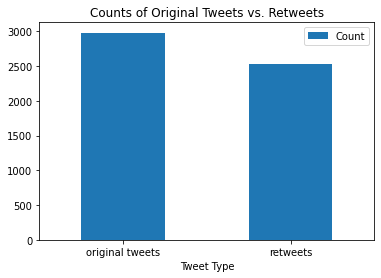


Count of original tweets: 2980
Count of retweets: 2534


In [ ]:
df = pd.DataFrame({'Tweet Type':['original tweets', 'retweets'], 'Count':[len(twitter[~retweets]), len(twitter[retweets])]})
ax = df.plot.bar(x='Tweet Type', y='Count', rot = 0)
plt.title("Counts of Original Tweets vs. Retweets")
plt.show()

print()
print("Count of original tweets:", len(twitter[~retweets]))
print("Count of retweets:", len(twitter[retweets]))

Observations:

The distribution of original tweets and retweets is almost even. There are slightly more originals (2954) than retweets (2534), which suggests that the users in our dataset are more concerned with producing original content than they are about amplifying the content of others.

2c) Replies vs. Non-Replies

In [ ]:
# creating mask
replies = twitter['Tweet Text'].str.startswith("@")
twitter[replies].head(10)

,Date,Screen Name,Full Name,Tweet Text,Tweet ID,App,Followers,Follows,Retweets,Favorites,Verfied,User Since,Location,Bio,Profile Image
17,4/28/16,@_mcisneros19,Mirella Cisneros,@doctormorrison Today at my nature journaling ...,726000000000000000.00,Twitter Web Client,13,47.00,0,1,No,2/4/16,"Elon, NC",Elon University | Class of 2019 | Middle Grade...,View
94,5/4/16,@academe_atl_hs,Academe of the Oaks,@TorontoWaldorf Looking great! Ours is coming ...,728000000000000000.00,Twitter Web Client,401,625.00,0,1,No,2/11/09,Atlanta,"Academe of the Oaks is an independent, non-sec...",View
159,4/27/16,@Alexis_Curious,Alexis Caudell,"@RangerRidley @KinderKids123 ""permission"" can ...",726000000000000000.00,Twitter for iPhone,126,64.00,0,0,No,8/11/13,Indiana,"Computing, Culture, & Society - Indiana Univer...",View
160,4/27/16,@Alexis_Curious,Alexis Caudell,@RangerRidley so tech seen as more rigid and l...,726000000000000000.00,Twitter for iPhone,126,64.00,0,0,No,8/11/13,Indiana,"Computing, Culture, & Society - Indiana Univer...",View
164,5/4/16,@aliceleung,Alice Leung,@ChrisVella2 I just realized you're moderator....,728000000000000000.00,Twitter for iPhone,5142,1926.00,0,2,No,4/15/09,"Sydney, Australia",Head Teacher Science at @merrylandshs . Mum of...,View
169,5/4/16,@aliceleung,Alice Leung,@ChrisVella2 Perhaps also how #enviroed fits i...,728000000000000000.00,Twitter for iPhone,5141,1926.00,0,4,No,4/15/09,"Sydney, Australia",Head Teacher Science at @merrylandshs . Mum of...,View
207,4/13/16,@amk_elon,Allie Kornacki,@RangerRidley @CWF_FCF A1 I'm not teaching yet...,720000000000000000.00,Twitter for iPhone,61,102.00,0,1,No,8/28/14,"Elon, NC",Elon University | Class of 2016 | [hopeful] Fu...,View
208,4/13/16,@amk_elon,Allie Kornacki,@RangerRidley @CWF_FCF A1 contd using local pl...,720000000000000000.00,Twitter for iPhone,61,102.00,0,0,No,8/28/14,"Elon, NC",Elon University | Class of 2016 | [hopeful] Fu...,View
211,4/13/16,@amk_elon,Allie Kornacki,"@CWF_FCF A2 Nature can be scary, limited, or b...",720000000000000000.00,TweetDeck,61,102.00,0,2,No,8/28/14,"Elon, NC",Elon University | Class of 2016 | [hopeful] Fu...,View
212,4/13/16,@amk_elon,Allie Kornacki,@CWF_FCF Since I'm not a T I don't know 1sthan...,720000000000000000.00,TweetDeck,61,102.00,0,3,No,8/28/14,"Elon, NC",Elon University | Class of 2016 | [hopeful] Fu...,View


In [ ]:
twitter[~replies].head(10)

,Date,Screen Name,Full Name,Tweet Text,Tweet ID,App,Followers,Follows,Retweets,Favorites,Verfied,User Since,Location,Bio,Profile Image
0,3/15/16,@_Lightscap3s_,Otis,"RT @NatureBridge: ""NatureBridge is Highlight o...",710000000000000000.00,RoundTeam,2644,590.00,1,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
1,3/21/16,@_Lightscap3s_,Otis,RT @NatureBridge: By 2050 we want more fish th...,712000000000000000.00,RoundTeam,2641,587.00,2,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
2,4/6/16,@_Lindsay_Conway,Lindsay,RT @savageducates: Greenest School on #Earth s...,718000000000000000.00,Twitter for iPhone,164,318.00,2,0,No,6/7/14,"Bratislava, Slovakia",International education. SEN interests. Adopti...,View
3,3/23/16,@_mcisneros19,Mirella Cisneros,A1: For math children could measure trunks to ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
4,3/23/16,@_mcisneros19,Mirella Cisneros,A2: Going outside & letting children find the ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
5,3/23/16,@_mcisneros19,Mirella Cisneros,A4: It is important to make Ss aware about the...,713000000000000000.00,TweetDeck,8,44.00,0,1,No,2/4/16,NaN,NaN,View
6,3/23/16,@_mcisneros19,Mirella Cisneros,A4: Learning how we may contribute to the cont...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View
7,3/28/16,@_mcisneros19,Mirella Cisneros,Has technology imprisoned children? Do they kn...,715000000000000000.00,Twitter Web Client,10,44.00,0,0,No,2/4/16,NaN,NaN,View
8,3/31/16,@_mcisneros19,Mirella Cisneros,Some helpful tips and activities for teaching ...,716000000000000000.00,Twitter Web Client,11,44.00,0,0,No,2/4/16,NaN,NaN,View
9,4/7/16,@_mcisneros19,Mirella Cisneros,"""...school isn't supposed to be a polite form ...",718000000000000000.00,Twitter Web Client,9,44.00,0,0,No,2/4/16,NaN,NaN,View


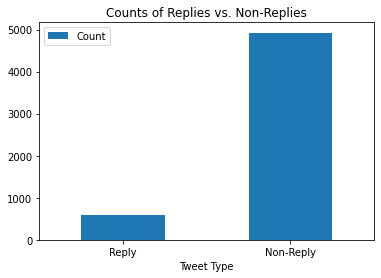


Count of replies: 590
Count of non-replies: 4924


In [ ]:
df = pd.DataFrame({'Tweet Type':['Reply', 'Non-Reply'], 'Count':[len(twitter[replies]), len(twitter[~replies])]})
ax = df.plot.bar(x='Tweet Type', y='Count', rot = 0)
plt.title("Counts of Replies vs. Non-Replies")
plt.show()

print()
print("Count of replies:",len(twitter[replies]))
print("Count of non-replies:",len(twitter[~replies]))

Observations:

There are significantly more non-replies (4924) than replies (590), suggesting that most of the tweeting is not done with the intention of interacting with others. That being said, retweets are grouped in with the non-replies, even though an argument could be made that retweeting is a form of interaction or acknowledgement. Still, most tweets are not responding to other users/content.

2d) Distribution of Follower Counts

In [ ]:
# descriptive statistics
pd.set_option('display.float_format', lambda x: '%.2f' % x)
print("Descriptive Statistics for 'Followers' Attribute")
print()
twitter['Followers'].describe()

Descriptive Statistics for 'Followers' Attribute



count     5514.00
mean      3841.14
std      22904.48
min          0.00
25%        311.00
50%        761.00
75%       2510.00
max     765634.00
Name: Followers, dtype: float64

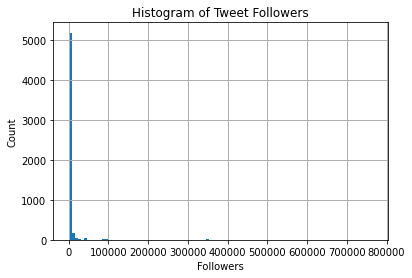

In [ ]:
# visualization 1
plt.hist(twitter['Followers'], bins = 100)
plt.xlabel('Followers')
plt.ylabel('Count')
plt.title('Histogram of Tweet Followers')
plt.grid(linewidth = 1)

plt.show()


It is difficult to see the distribution from the histogram above because the scale is ruined by a few extreme outliers...We have restricted the range of values in the visualization below from 0 to 5,000 followers.

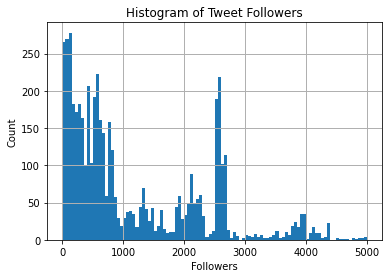

In [ ]:
# visualization 2 (restricted x-axis)
plt.hist(twitter['Followers'], bins = 100, range = (0, 5000))
plt.xlabel('Followers')
plt.ylabel('Count')
plt.title('Histogram of Tweet Followers')
plt.grid(linewidth = 1)

plt.show()


Observations:

The vast majority of tweets came from accounts with anywhere from 0 to a few thousand followers. The count drops off significantly after about the 3,000-follower mark. It is also worth noting that there are a few significant outliers who have hundreds of thousands of followers (max value was 765,634). This significantly increases the mean value (3841.44).

2e) Follows Counts vs. Followers Counts

In [ ]:
# descriptive statistics
pd.set_option('display.float_format', lambda x: '%.2f' % x)
print("Descriptive Statistics for 'Follows' Attribute")
print()
twitter['Follows'].describe()

Descriptive Statistics for 'Follows' Attribute



count    5513.00
mean     1304.56
std      2501.91
min         0.00
25%       324.00
50%       834.00
75%      1358.00
max     70393.00
Name: Follows, dtype: float64

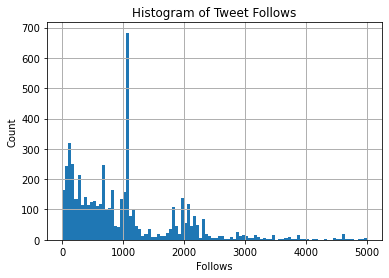

In [ ]:
# follows visualization (restricted x-axis)
plt.hist(twitter['Follows'], bins = 100, range = (0, 5000))
plt.xlabel('Follows')
plt.ylabel('Count')
plt.title('Histogram of Tweet Follows')
plt.grid(linewidth = 1)

plt.show()

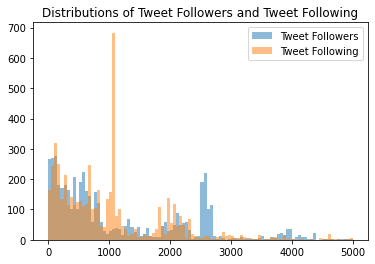

In [ ]:
plt.hist(twitter['Followers'], alpha=0.5,
         label='Tweet Followers', range = (0,5000), bins = 100)
  
plt.hist(twitter['Follows'], alpha=0.5,
         label='Tweet Following', range = (0, 5000), bins = 100)

plt.legend(loc='upper right')
plt.title('Distributions of Tweet Followers and Tweet Following')
plt.show()

Observations:

Again, we restricted the range of the histograms in order to see the distributions in more detail. Overall, the distributions of follows counts and followers counts are fairly similar. There is a significant spike in the follows distribution near the 1000 mark, indicating that a lot of these tweets came from users who were following around 1000 other accounts. There is also a smaller spike in the followers counts around the 2,500 mark that is not present in the follows distribution. Other than those two instances, the distributions appear to be pretty similar (slight right skew for both).

2f) Tweet Locations

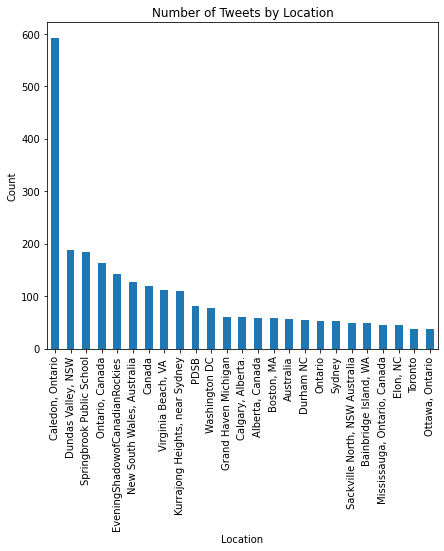

In [ ]:
# top locations based on number of tweets
twitter['Location'].value_counts().nlargest(25).plot(kind='bar', figsize=(7, 6))
plt.xlabel('Location')
plt.ylabel('Count')
plt.title('Number of Tweets by Location')
plt.show()

In [ ]:
# dropping rows with duplicate 'screen names'
unique = twitter.drop_duplicates(subset = ["Screen Name"])
# unique.head(25)

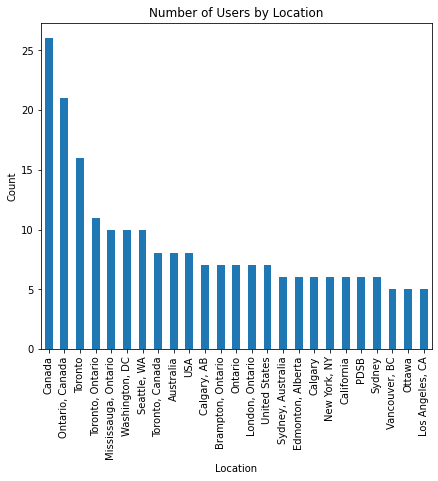

In [ ]:
# top locations based on number of users
unique['Location'].value_counts().nlargest(25).plot(kind='bar', figsize=(7, 6))
plt.xlabel('Location')
plt.ylabel('Count')
plt.title('Number of Users by Location')
plt.show()

Observations:

The majority of top locations in terms of tweet quantity also have the most users. "Canada" leads both categories, and cities such as Toronto, Virginia Beach, Washington DC, etc. also appear on both visualizations. Locations that appear on the first visualization but not the second, such as Springbrook Public School, have users who tweet at a relatively high rate. Conversely, locations that are on the second chart but not the first chart, such as Seattle, have users who tweet at a relatively low rate. 

2g) Tweet Times

In [ ]:
# converting 'date' from object to date
twitter_sorted = twitter
twitter_sorted['Date_new'] = pd.to_datetime(twitter_sorted['Date']).dt.date
twitter_sorted['day-of-week'] = pd.to_datetime(twitter_sorted['Date']).dt.dayofweek

In [ ]:
twitter_sorted.head(10)

,Date,Screen Name,Full Name,Tweet Text,Tweet ID,App,Followers,Follows,Retweets,Favorites,Verfied,User Since,Location,Bio,Profile Image,Date_new,day-of-week
0,3/15/16,@_Lightscap3s_,Otis,"RT @NatureBridge: ""NatureBridge is Highlight o...",710000000000000000.00,RoundTeam,2644,590.00,1,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View,2016-03-15,1
1,3/21/16,@_Lightscap3s_,Otis,RT @NatureBridge: By 2050 we want more fish th...,712000000000000000.00,RoundTeam,2641,587.00,2,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View,2016-03-21,0
2,4/6/16,@_Lindsay_Conway,Lindsay,RT @savageducates: Greenest School on #Earth s...,718000000000000000.00,Twitter for iPhone,164,318.00,2,0,No,6/7/14,"Bratislava, Slovakia",International education. SEN interests. Adopti...,View,2016-04-06,2
3,3/23/16,@_mcisneros19,Mirella Cisneros,A1: For math children could measure trunks to ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View,2016-03-23,2
4,3/23/16,@_mcisneros19,Mirella Cisneros,A2: Going outside & letting children find the ...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View,2016-03-23,2
5,3/23/16,@_mcisneros19,Mirella Cisneros,A4: It is important to make Ss aware about the...,713000000000000000.00,TweetDeck,8,44.00,0,1,No,2/4/16,NaN,NaN,View,2016-03-23,2
6,3/23/16,@_mcisneros19,Mirella Cisneros,A4: Learning how we may contribute to the cont...,713000000000000000.00,TweetDeck,8,44.00,0,0,No,2/4/16,NaN,NaN,View,2016-03-23,2
7,3/28/16,@_mcisneros19,Mirella Cisneros,Has technology imprisoned children? Do they kn...,715000000000000000.00,Twitter Web Client,10,44.00,0,0,No,2/4/16,NaN,NaN,View,2016-03-28,0
8,3/31/16,@_mcisneros19,Mirella Cisneros,Some helpful tips and activities for teaching ...,716000000000000000.00,Twitter Web Client,11,44.00,0,0,No,2/4/16,NaN,NaN,View,2016-03-31,3
9,4/7/16,@_mcisneros19,Mirella Cisneros,"""...school isn't supposed to be a polite form ...",718000000000000000.00,Twitter Web Client,9,44.00,0,0,No,2/4/16,NaN,NaN,View,2016-04-07,3


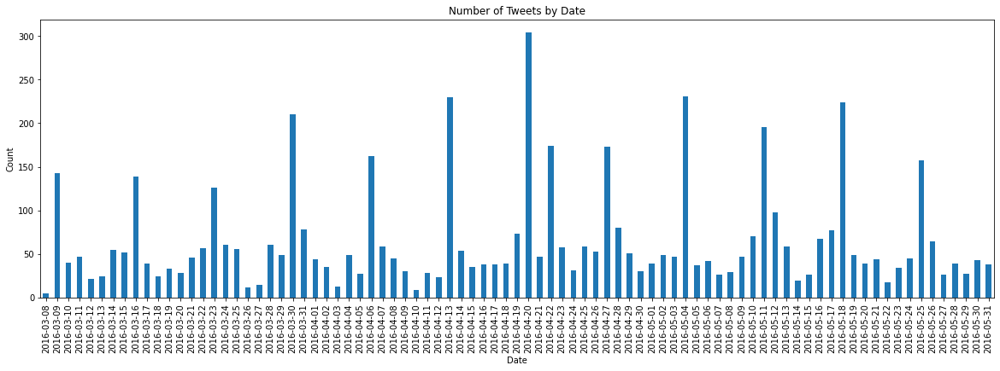

In [ ]:
# visualization for date
twitter_sorted['Date_new'].value_counts(sort = "Date_new").sort_index().plot(kind='bar', figsize=(20, 6))
plt.xlabel('Date')
plt.ylabel('Count')
plt.title('Number of Tweets by Date')
plt.show()

Observations:

At first glance, the distribution of tweet count by date appears to be random. That is certainly true in some parts of the visualization, but upon further examination, there are a few patterns. First, we can begin to see the pattern that Wednesday is the most popular day for tweeting, as there are consistent spikes on almost every Wednesday throughout the graph. Apart from Wednesdays, the largest spike falls on April 22, which is Earth Day. Considering that the dataset is centered around educators interested in environmental education, this pattern makes a lot of sense.

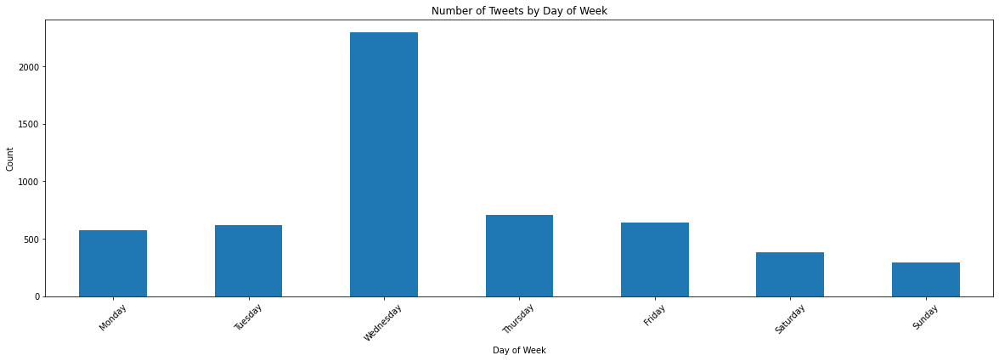

In [ ]:
# visualization for day of week
twitter_sorted['day-of-week'].value_counts().sort_index(ascending = True).plot(kind='bar', figsize=(20, 6))
plt.xlabel('Day of Week')
ax = plt.gca()
ax.set_xticklabels(["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"], rotation = 45)
plt.ylabel('Count')
plt.title('Number of Tweets by Day of Week')
plt.show()

Observations:

The visualization above shows an interesting trend in the data. Wednesday is by far the most popular day for tweeting, with just under half of the total tweets falling on a Wednesday. The rest of the days are fairly similar to each other. We can also see that there is a slight but steady decline in the amount of tweets from Thursday through the end of the week.

2h) What are people tweeting?

In [ ]:
text = twitter["Tweet Text"]
print(text)

0       RT @NatureBridge: "NatureBridge is Highlight o...
1       RT @NatureBridge: By 2050 we want more fish th...
2       RT @savageducates: Greenest School on #Earth s...
3       A1: For math children could measure trunks to ...
4       A2: Going outside & letting children find the ...
                              ...                        
5509    RT @RangerRidley: Today mind was reopened when...
5510    RT @AAPremlall: Native #Bees of Eastern North ...
5511    RT @EPAregion2: K-12 educators using innovativ...
5512    #schoolgardens can make great outdoor classroo...
5513    A mental-mapping exercise with Gr6/7 students ...
Name: Tweet Text, Length: 5514, dtype: object


In [ ]:
text.head(10)

0    RT @NatureBridge: "NatureBridge is Highlight o...
1    RT @NatureBridge: By 2050 we want more fish th...
2    RT @savageducates: Greenest School on #Earth s...
3    A1: For math children could measure trunks to ...
4    A2: Going outside & letting children find the ...
5    A4: It is important to make Ss aware about the...
6    A4: Learning how we may contribute to the cont...
7    Has technology imprisoned children? Do they kn...
8    Some helpful tips and activities for teaching ...
9    "...school isn't supposed to be a polite form ...
Name: Tweet Text, dtype: object

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

# Specify stop words that should be ignored.
stop_words = ['i', 'im', 'a', 'to', 'and', 'the', 'my', 'have', 'is', 'in', 'as', 'are', 'ive', 'have', 'it', 'on']

count_vect = CountVectorizer(lowercase=True, stop_words=stop_words)
sparse_counts = count_vect.fit_transform(twitter['Tweet Text'])
print(sparse_counts.shape)
terms = count_vect.get_feature_names()
print (terms)
counts = sparse_counts.todense()
print (counts)

(5514, 8762)
['00', '000', '0192av9i7z', '01ai6yvl', '01ai6yvlft', '02nb5hbfcm', '03', '04', '05', '06', '07c2rka1po', '09', '0ajbweg1ld', '0bnjoa6xvo', '0cseubupmx', '0d4td9fhwp', '0dfqscseei', '0eeomxqarx', '0ercf876wx', '0f3bawbdwf', '0g0bsaxmqy', '0h8fk5fvur', '0hjegqbdq9', '0i1c9egxif', '0iat8ym', '0iat8ymsvi', '0jlffqg0te', '0jn6mc', '0jn6mc7ygl', '0kiyz83zs8', '0krgrvlxau', '0llpcyde8d', '0lx0mfywzj', '0nbtp3n9zq', '0ur03pvciz', '0urpbyfg1p', '0wr0l2kd8h', '0wr5retkrq', '0x2ccryno1', '0xwshpscvz', '0y5ioobqrg', '0yckyj0ugz', '0yyqqscezx', '0yzp6ltryr', '0zcwbpxhll', '10', '100', '100yo', '100yrs', '10dmeqi5kb', '10pm', '10th', '11', '11am', '11th', '12', '1230', '12ig1zcoxe', '12th', '13', '1390', '13th', '14', '145', '14ggpa7q83', '14u242rqs7', '15', '15min', '15w60somls', '16', '165', '16eiawards', '16th', '17', '17th', '18', '1850', '18th', '19', '1970', '19th', '1aooua2mv9', '1c4badhzl1', '1dr2eolpdp', '1fr0qiiosv', '1gj6z3glwg', '1hnfctn1wf', '1hr', '1ismvkqve1', '1kqqf1wbh

In [ ]:
x = count_vect.get_feature_names()
y = np.array(sparse_counts.todense()).sum(axis=0)
df = pd.DataFrame()
df['term'] = x
df['count'] = y
df = df.sort_values(by='count')
df

,term,count
4380,krdwf3lla1,1
6087,prioritizing,1
6084,prints,1
2959,fewer,1
6080,princeton,1
...,...,...
3079,for,1662
6659,rt,2561
1666,co,3721
3766,https,4204


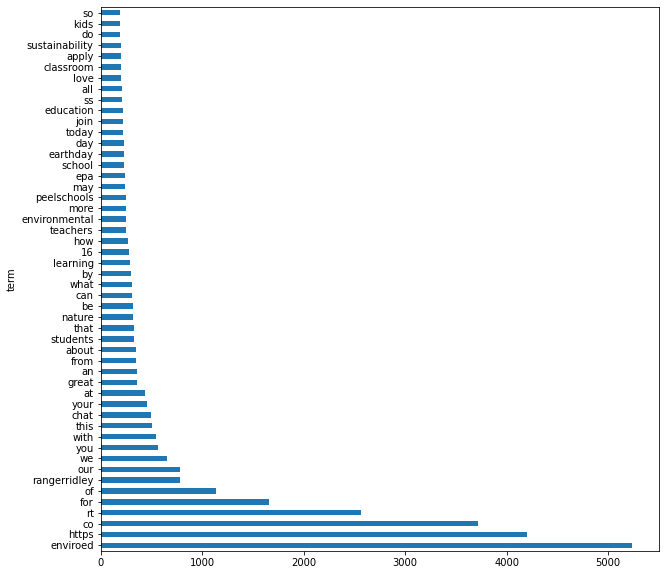

In [ ]:
top_words = df.sort_values(by = 'count', ascending = False)
top_words[:50].plot(y='count', x='term', kind='barh', legend=None, figsize = (10,10))

#df['term'].value_counts().nlargest(50).plot(kind='bar', figsize=(7, 6))


Observations:

Above shows our graph of the 50 most common words used in tweets. The word that occurred in the most tweets was enviroed (5,236 times) and https was second (4,204 times). They occurred a lot more than words like, so, kids, and do, who only occurred a few times. Twitter users are expanding more on their vocaublary in the use of tweets and also provide links to websites (https), whether being videos or articles of news sources (funny, serious/crucial, etc) and everyday events that happen.

In [ ]:
# Specify stop words that should be ignored.
stop_words = ['i', 'im', 'a', 'to', 'and', 'the', 'my', 'have', 'is', 'in', 'as', 'are', 'ive', 'have', 'it', 'on']

count_vect_hashtags = CountVectorizer(lowercase=True, stop_words=stop_words, token_pattern=r"(\#\w+)")
sparse_counts_hashtags = count_vect_hashtags.fit_transform(twitter['Tweet Text'])
print(sparse_counts_hashtags.shape)
terms_hashtags = count_vect_hashtags.get_feature_names()
print (terms_hashtags)
counts_hashtags = sparse_counts_hashtags.todense()
print (counts_hashtags)

(5514, 1004)
['#16eiawards', '#1to1techat', '#2015fpa', '#2016unconference', '#2ndchat', '#3', '#30x30challenge', '#3rdchat', '#7thchat', '#8ways', '#aaee', '#abed', '#abenviro', '#abjobs', '#ableg', '#abndp', '#aboriginal', '#abpoli', '#academehs', '#access', '#accreditation', '#acee', '#activism', '#activities', '#adaptation', '#addisababa', '#adechat', '#adedu', '#advocacy', '#aee530', '#aera16', '#aera2016', '#aesthetics', '#afterschool', '#afterschoolee', '#agbu', '#agedu', '#agricultu', '#agriculture', '#agroforestry', '#air', '#airquality', '#alameda', '#alberta', '#alternat', '#alternativeenergy', '#anim', '#animalbehavior', '#animals', '#animoto', '#apchemchat', '#appinve', '#appinventor', '#appreciatenature', '#apps', '#aquariums', '#arborday', '#arkansasgives', '#armenia', '#armenian', '#art', '#arted', '#ash', '#asksylvia', '#astronomy', '#atchat', '#aussieed', '#awareness', '#banplasticstraws', '#basil', '#bc', '#bced', '#bcedchat', '#bclearns', '#bcpoli', '#beauty', '#bee

In [ ]:
x2 = count_vect_hashtags.get_feature_names()
y2 = np.array(sparse_counts_hashtags.todense()).sum(axis=0)
df2 = pd.DataFrame()
df2['term'] = x2
df2['count'] = y2
df2 = df2.sort_values(by='count')
df2

,term,count
501,#justsayin,1
545,#lter,1
546,#macroom,1
547,#macroomlibrary,1
549,#mainers,1
...,...,...
670,#outdoored,90
855,#sustainability,106
254,#edchat,139
216,#earthday,231


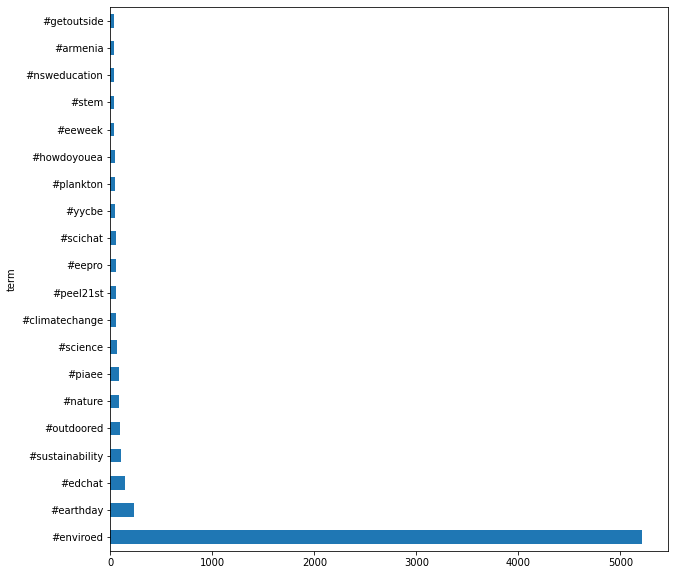

In [ ]:
top_words2 = df2.sort_values(by = 'count', ascending = False)
top_words2[:20].plot(y='count', x='term', kind='barh', legend=None, figsize = (10,10))

#df['term'].value_counts().nlargest(50).plot(kind='bar', figsize=(7, 6))

Observations:

Above shows our graph of the 20 most common topics used in tweets, starting with a #. The most common topic that occurred in the most tweets was #enviroed (5,212 times) and #earthday was second (231 times). #enviroed occurred a lot more than anyother topic did. Twitter users are going to use more relevant hashtags in relation to the context of their post. It makes sense that the most common topic is #enviroed, since the word itself is also the most common word that has occurred in tweets (5,236 times).

2i) Who is tweeting? (SNA)

In [ ]:
mentions = twitter['Tweet Text'].str.contains("@")

In [ ]:
# Create lists
nodes = []
for i, row in unique.iterrows():
    nodes.insert(2,row['Screen Name'])

#nodes


In [ ]:
import pandas as pd

G = nx.DiGraph()

# Loop through each row in the dataframe
for idx, row in twitter.iterrows():
  #print('Processing row:', idx)
  from_node = row['Screen Name']
  for node in nodes:
    if node in row['Tweet Text']:
      to_node = node
      if G.has_edge(from_node, to_node):
        w = G.get_edge_data(from_node, to_node)['weight']
        #print('  found existing edge, increasing weight to:', w+1)
        G.add_edge(from_node, to_node, weight=w+1)
      else:
        # Otherwise, add the edge with a weight of 1
        #print('  adding edge with weight: 1')
        G.add_edge(from_node, to_node, weight=1)


In [ ]:
edge_weights = [G.edges[v, w]["weight"] for v, w in G.edges]
print(len(edge_weights))

2966


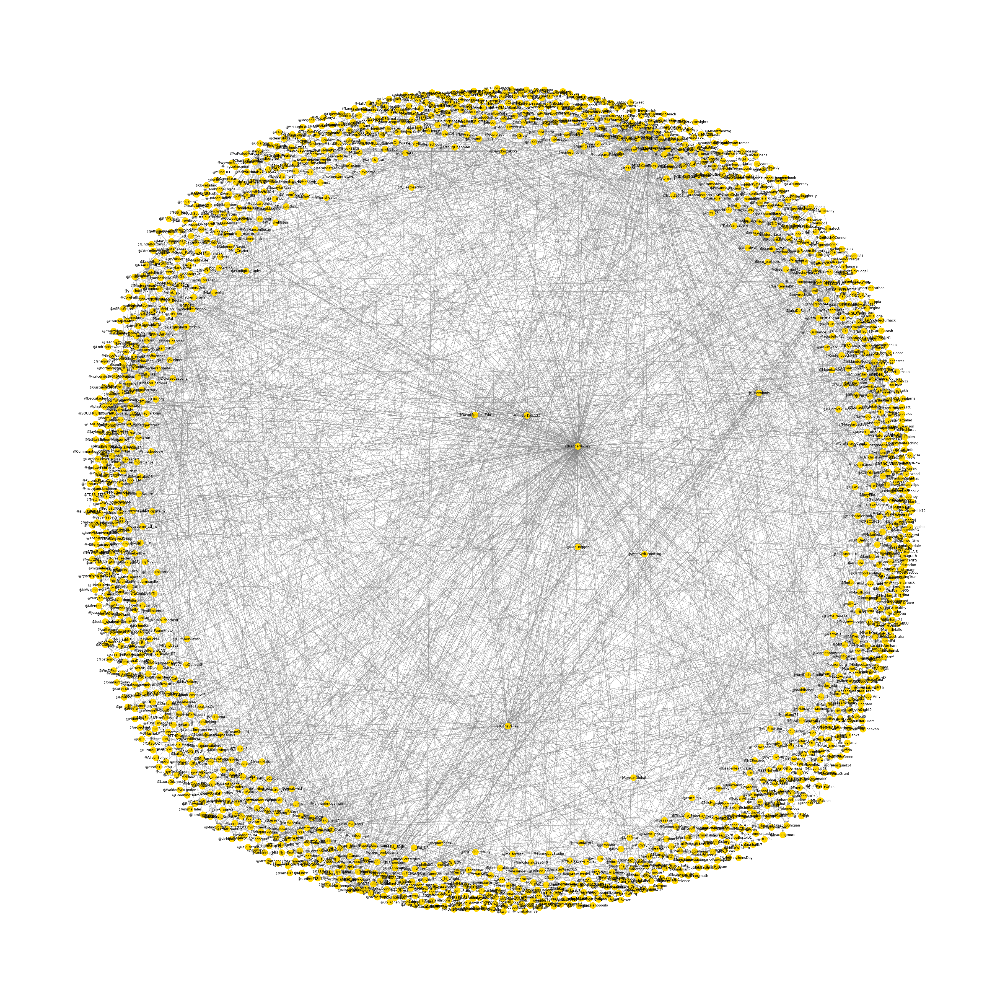

In [ ]:
plt.figure(figsize=(50, 50))

# Calculate the best position for laying out the nodes graphically.
pos = nx.spring_layout(G, k=2.0) # k controls how far apart nodes are forced to be

nx.draw(G, pos=pos, with_labels=True,
        node_color='gold', node_size=500,
        edge_color='grey', width=0.5)
plt.show()

In [ ]:
print('Nodes:', list(G.nodes))

# or edges
print('Edges:', list(G.edges))

Nodes: ['@_Lightscap3s_', '@NatureBridge', '@_Lindsay_Conway', '@savageducates', '@_mcisneros19', '@doctormorrison', '@sgilley12', '@paigebl213', '@DannyBavis', '@amk_elon', '@_swatik_', '@EnviroEducators', '@_withah', '@ItsAboutTimeEDU', '@02Benson', '@GreeningForward', '@COrgbon', '@109ThornKs', '@RangerRidley', '@1915Aurora', '@JasonSohigian', '@CivilNetTV', '@ArmeniaTree', '@1GratefulWorld', '@OLVPrincipal', '@MrsEimers', '@fatim_to', '@CNC90', '@1stof7gens', '@RachelNotley', '@GEOEC', '@cgeducation', '@AlbertaEE', '@2015_Project', '@22C0in', '@EPA', '@2LisaMayer', '@actionbonnie', '@3PennyMovies', '@Sierra_BC', '@3wlittlefalls', '@MahaffyStars', '@500eco', '@5intadewi', '@CKEnvCentre', '@6Veronicadr', '@MHEducation', '@A_Dobbie11', '@PeelSchools', '@KinderKids123', '@AACPS_PGD', '@MindShiftKQED', '@AAPCA_States', '@AAPremlall', '@ZoeWeil', '@SustyQ', '@stevenbody', '@ChrisVella2', '@PaulKelba', '@ycedillo94', '@aarniolinna', '@eerjournal', '@aaronpaquette', '@aawasp', '@EPAregion2

In [ ]:
print(len(nodes))

1613


In [ ]:
G.number_of_edges()

2966

In [ ]:
G = nx.DiGraph(G)
print(nx.info(G))

Name: 
Type: DiGraph
Number of nodes: 1511
Number of edges: 2966
Average in degree:   1.9629
Average out degree:   1.9629


In [ ]:
density = nx.density(G)
print("Network density:", density)
print("Manual calculation:", G.number_of_edges() / (G.number_of_nodes()*(G.number_of_nodes()-1)))

Network density: 0.0012999592393090843
Manual calculation: 0.0012999592393090843


In [ ]:
# networkx can calculate these measures and return a dictionary
# with a key for each node.
print('- Degree Centrality:\n', nx.degree_centrality(G))
print('\n- Betweenness Centrality:\n', nx.betweenness_centrality(G))
print('\n- Closeness Centrality:\n', nx.closeness_centrality(G))
print('\n- Eigenvector Centrality\n', nx.eigenvector_centrality(G))

- Degree Centrality:
 {'@_Lightscap3s_': 0.0006622516556291391, '@NatureBridge': 0.009933774834437087, '@_Lindsay_Conway': 0.0006622516556291391, '@savageducates': 0.0026490066225165563, '@_mcisneros19': 0.005298013245033113, '@doctormorrison': 0.025827814569536423, '@sgilley12': 0.0026490066225165563, '@paigebl213': 0.001986754966887417, '@DannyBavis': 0.006622516556291391, '@amk_elon': 0.011258278145695364, '@_swatik_': 0.0006622516556291391, '@EnviroEducators': 0.05231788079470199, '@_withah': 0.0006622516556291391, '@ItsAboutTimeEDU': 0.006622516556291391, '@02Benson': 0.0013245033112582781, '@GreeningForward': 0.001986754966887417, '@COrgbon': 0.0033112582781456954, '@109ThornKs': 0.0006622516556291391, '@RangerRidley': 0.23112582781456953, '@1915Aurora': 0.001986754966887417, '@JasonSohigian': 0.005960264900662251, '@CivilNetTV': 0.009933774834437087, '@ArmeniaTree': 0.015231788079470199, '@1GratefulWorld': 0.0026490066225165563, '@OLVPrincipal': 0.009933774834437087, '@MrsEimers

In [ ]:
# It's often helpful to assign attributes to nodes in the network.

degree_dict = dict(G.degree(G.nodes()))
nx.set_node_attributes(G, degree_dict, 'degree')

# in_degree only works for directed graphs
in_degree_dict = dict(G.in_degree(G.nodes()))
nx.set_node_attributes(G, in_degree_dict, 'in_degree')

# out_degree only works for directed graphs
out_degree_dict = dict(G.out_degree(G.nodes()))
nx.set_node_attributes(G, out_degree_dict, 'out_degree')

betweenness_dict = nx.betweenness_centrality(G) # Run betweenness centrality
nx.set_node_attributes(G, betweenness_dict, 'betweenness')

eigenvector_dict = nx.eigenvector_centrality(G) # Run eigenvector centrality
nx.set_node_attributes(G, eigenvector_dict, 'eigenvector')

In [ ]:
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by betweenness centrality:")
for b in sorted_betweenness[:20]:
    print(b)

Top 20 nodes by betweenness centrality:
('@RangerRidley', 0.0592180253584604)
('@PaulKelba', 0.018237631301792113)
('@NAAEEStaff', 0.015296821530922022)
('@Learn_OnTheFly', 0.015284828922776692)
('@EnviroEducators', 0.00807567055095686)
('@IslandWood', 0.007102338727653064)
('@GEOEC', 0.006727119183565615)
('@CWF_FCF', 0.006044599037847254)
('@DavidSpencerEdu', 0.00517290486162789)
('@doctormorrison', 0.00495635599288486)
('@PDSB_eco', 0.004440303346113509)
('@KinderKids123', 0.004403431385971579)
('@EZECNSW', 0.0038381985557532448)
('@Sierra_BC', 0.0038144169082240933)
('@perfinker', 0.0032255212366268)
('@PeelSchools', 0.003221253055272266)
('@stevenbody', 0.0029915154716094287)
('@CreativeSTAR', 0.002984236323462035)
('@ChrisVella2', 0.0028833358826087408)
('@AAPremlall', 0.002713031050732275)


In [ ]:
sorted_eigenvector = sorted(eigenvector_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by eigenvector centrality:")
for b in sorted_eigenvector[:20]:
    print(b)

Top 20 nodes by eigenvector centrality:
('@RangerRidley', 0.4361236243939317)
('@ChrisVella2', 0.24746260317785637)
('@EZECNSW', 0.23541902464795714)
('@stevenbody', 0.22491615382764313)
('@PaulKelba', 0.19841387914159445)
('@LShenstone', 0.17665308638873434)
('@vivianharris45', 0.16931699669725034)
('@PeelSchools', 0.16660698645683736)
('@KinderKids123', 0.1602981345855057)
('@KateHelene', 0.14976560896150792)
('@DebHoggoz', 0.14880473229105734)
('@doctormorrison', 0.14716914372196674)
('@KinderFynes', 0.14219095514276323)
('@steve_papp', 0.13609153619599457)
('@BrewongleEEC', 0.1299930990440206)
('@FieldofMarsEEC', 0.12845531506311833)
('@CWF_FCF', 0.12287961433455544)
('@MikeBartlettEdu', 0.11669270807331626)
('@LongneckLagoon', 0.11626310823574884)
('@CherineSpirou', 0.10969633661583042)


In [ ]:
sorted_in_degree = sorted(in_degree_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by in-degree:")
for b in sorted_in_degree[:20]:
    print(b)

Top 20 nodes by in-degree:
('@RangerRidley', 245)
('@EPA', 169)
('@PeelSchools', 91)
('@EnviroEducators', 70)
('@PaulKelba', 60)
('@KinderKids123', 54)
('@CWF_FCF', 48)
('@PDSB_eco', 45)
('@IslandWood', 45)
('@ChrisVella2', 41)
('@NAAEEStaff', 40)
('@Sierra_BC', 39)
('@stevenbody', 39)
('@MindShiftKQED', 38)
('@KinderFynes', 38)
('@EZECNSW', 37)
('@CreativeSTAR', 36)
('@ON_EcoSchools', 35)
('@PlanktonPundit', 35)
('@GEOEC', 34)


In [ ]:
sorted_out_degree = sorted(out_degree_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by out-degree:")
for b in sorted_out_degree[:20]:
    print(b)

Top 20 nodes by out-degree:
('@RangerRidley', 104)
('@DavidSpencerEdu', 47)
('@PaulKelba', 37)
('@Learn_OnTheFly', 37)
('@stevenbody', 29)
('@EZECNSW', 28)
('@ChrisVella2', 27)
('@KinderKids123', 18)
('@CWF_FCF', 16)
('@doctormorrison', 14)
('@OCSBeco', 14)
('@WestSydUFood_Ag', 14)
('@PDSB_eco', 13)
('@vivianharris45', 13)
('@MikeBartlettEdu', 13)
('@KinderFynes', 12)
('@NAAEEStaff', 12)
('@PeelSchools', 11)
('@BearTrust', 11)
('@BrewongleEEC', 11)


We observed the top 20 twitter users using business centrality, eigenvector centrality, in-degree, and out-degree. The top 20 twitter users have high in and out degrees, much greater than their averages in the relative network density shown. The highest in-degree is @RangerRidley (245) and the highest out-degree is also @RangerRidley (104). @RangerRidley shares the most similarities with the other twitter users, as @RangerRidley was mentioned the most in tweets. It also so happens to have the highest out-degree, meaning it is linked to having more peers/followers. The highest betweeness centrality appears at @RangerRidley (0.0592) and the highest eigenvector centrality appears at @RangerRidely (0.4361). These numbers are very different, but significant at the same time. @RangerRidley has the highest business centrality, meaning that there are more shortest paths for twitter users to be mentioned (linked around @RangerRidley). @RangerRidley also has the highest eigenvector, meaning it is the most highly connected twitter user in the data.
Overall, the four lists are very different. The values could be different based on a variety of reasons, such as the number of the twitter users, how many tweets are sent, how many tweets are retweeted, the number of people mentioned in the tweets, and the location of the twitter users (distance). These factors could be significant in determining which twitter users are similar to each other and share the same values. In this case, there is no one metric that is better suited to predict the mentioning of twitter users in tweets.

In [ ]:
Three twitter users?

In [ ]:
# View all the attributes associated with a given node
print('@DavidSpencerEdu:')
G.nodes['@DavidSpencerEdu']

@DavidSpencerEdu:


{'betweenness': 0.00517290486162789,
 'degree': 61,
 'eigenvector': 0.009793362018897843,
 'in_degree': 14,
 'out_degree': 47}

In [ ]:
# View all the attributes associated with a given node
print('@KinderKids123:')
G.nodes['@KinderKids123']

@KinderKids123:


{'betweenness': 0.004403431385971579,
 'degree': 72,
 'eigenvector': 0.1602981345855057,
 'in_degree': 54,
 'out_degree': 18}

In [ ]:
# View all the attributes associated with a given node
print('@DebHoggoz:')
G.nodes['@DebHoggoz']

@DebHoggoz:


{'betweenness': 6.215236108213617e-05,
 'degree': 24,
 'eigenvector': 0.14880473229105734,
 'in_degree': 15,
 'out_degree': 9}

In [ ]:
# View all the attributes associated with a given node
print('@WestSydUFood_Ag:')
G.nodes['@WestSydUFood_Ag']

@WestSydUFood_Ag:


{'betweenness': 0.00083749676822715,
 'degree': 21,
 'eigenvector': 0.08399752464429042,
 'in_degree': 7,
 'out_degree': 14}

In [ ]:
# View all the attributes associated with a given node
print('@stevenbody:')
G.nodes['@stevenbody']

@stevenbody:


{'betweenness': 0.0029915154716094287,
 'degree': 68,
 'eigenvector': 0.22491615382764313,
 'in_degree': 39,
 'out_degree': 29}

In [ ]:
# View all the attributes associated with a given node
print('@SensusGlobal:')
G.nodes['@SensusGlobal']

@SensusGlobal:


{'betweenness': 0.0,
 'degree': 1,
 'eigenvector': 8.211879969254616e-23,
 'in_degree': 0,
 'out_degree': 1}

In [ ]:
# View all the attributes associated with a given node
print('@RangerRidley:')
G.nodes['@RangerRidley']

@RangerRidley:


{'betweenness': 0.0592180253584604,
 'degree': 349,
 'eigenvector': 0.4361236243939317,
 'in_degree': 245,
 'out_degree': 104}

In [ ]:
# View all the attributes associated with a given node
print('@ChrisVella2:')
G.nodes['@ChrisVella2']

@ChrisVella2:


{'betweenness': 0.0028833358826087408,
 'degree': 68,
 'eigenvector': 0.24746260317785637,
 'in_degree': 41,
 'out_degree': 27}

In [ ]:
# View all the attributes associated with a given node
print('@PaulKelba:')
G.nodes['@PaulKelba']

@PaulKelba:


{'betweenness': 0.018237631301792113,
 'degree': 97,
 'eigenvector': 0.19841387914159445,
 'in_degree': 60,
 'out_degree': 37}

We selected @RangerRidley, @ChrisVella2, and @PaulKelba. They are all twitter users that appeared in the top 20 lists for business centrality, eigenvector centrality, in-degree, and out-degree. @RangerRidley and @PaulKelba have similar betweeness centralities, meaning that they are closer to each other. @RangerRidley has the biggest betweeness centrality, meaning it has the highest connections of the three twitter users. More twitter users mention @RangerRidley and there are more shorter paths linked to @RangerRidley.
@ChrisVella2 and @PaulKelba are pretty close when it comes to in-degrees. @ChrisVella2 has an in-degree of 41 and @PaulKelba has one of 60. The two twitter users may share a lot of the same similarities with each other and may be linked to one another. @ChrisVella2 has the lowest in-degree of 41, which is still pretty high compared to the average (1.9629). In the case for out-degree, @RangerRidley has the highest out-degree at 104, which is a lot higher than both @PaulKelba (37) and @ChrisVella2 (27). This means that @RangerRidley may link itself as being mentioned to more peers (twitter users/followers) in tweets, than @ChrisVella2 and @PaulKelba. Since @ChrisVella2 and @PaulKelba are similar in out-degrees, they may be scene as pairs. Lastly, when observing the eigenvector centrality, @RangerRidley has the highest one (0.4361). Its eigenvector centrality is much greater than the other two twitter users, indicating its edges (links) are more highly connected to other twitter users/followers when being mentioned.

2j) Additional Analysis: 

Earlier in the assignment, we compared the counts of retweets vs. non-retweets. We decided to expand on this idea because we were interested if that distribution varied depending on the application that the tweet was posted from. We were hoping to gain some insight as to whether there were differences in the distributions of retweets and non-retweets across the most popular applications.

Text(0.5, 1.0, 'Distribution of Apps (Retweets)')

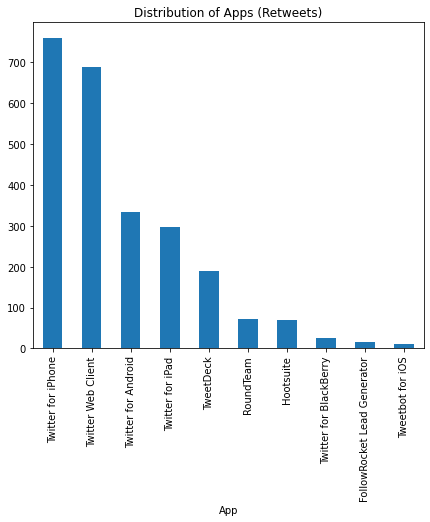

In [ ]:
# retweets
twitter[retweets].groupby(['App']).count()

rt = twitter[retweets].groupby(['App']).count().sort_values(by = 'Date', ascending = False)
rt['Date'].nlargest(10).plot(kind='bar', figsize=(7, 6))
plt.title("Distribution of Apps (Retweets)")

Text(0.5, 1.0, 'Distribution of Apps (non-Retweets)')

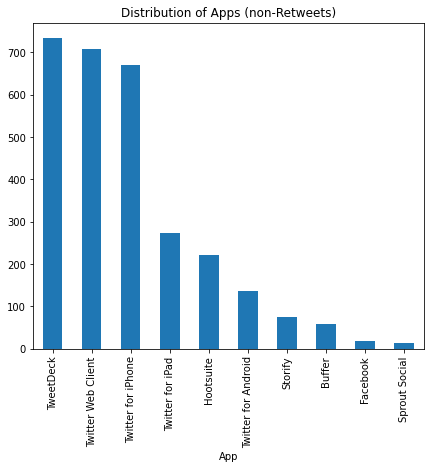

In [ ]:
# non-retweets
nrt = twitter[~retweets].groupby(['App']).count().sort_values(by = 'Date', ascending = False)
nrt['Date'].nlargest(10).plot(kind='bar', figsize=(7, 6))
plt.title("Distribution of Apps (non-Retweets)")

In [ ]:
a = rt['Date'].dropna(axis = 0)
b = nrt['Date'].dropna(axis = 0)

d = {'retweets': a.nlargest(30), 'non-retweets': b.nlargest(30)}
df = pd.DataFrame(data=d)
final_rt = df.dropna(axis = 0).sort_values(by = 'retweets', ascending = False)
final_nrt = df.dropna(axis = 0).sort_values(by = 'non-retweets', ascending = False)

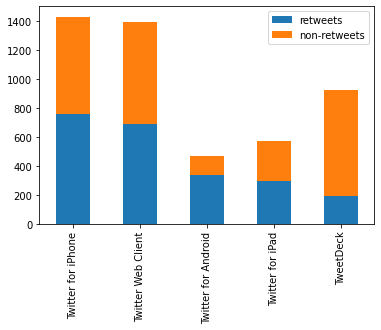

In [ ]:
# stacked bar chart (sorted by retweets)
ax = final_rt[:5].plot.bar(stacked=True)

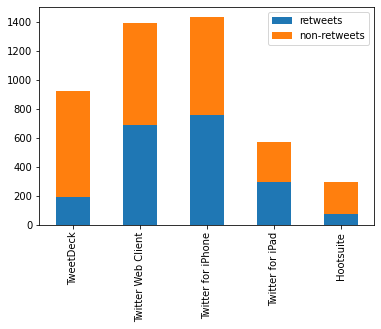

In [ ]:
# stacked bar chart (sorted by non-retweets)
ax = final_nrt[:5].plot.bar(stacked=True)

Observations:

There are a few notable conclusions that we can draw based on these visualizations. First, TweetDeck had the most uneven distribution of retweets vs. non-retweets. This app had the fewest number of retweets out of the top apps and the largest number of non-retweets. Twitter web client, Twitter for iPhone, and Twitter for iPad had fairly even distributions. Of the remaining apps in the visualizations, Twitter for Android had significantly more retweets than non-retweets, and Hootsuite had significanty more non-retweets than retweets. These observations clearly indicate that certain applications are more suited for sharing original content, while others are more commonly used for spreading existing content.